In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
ls /content/gdrive/'My Drive'/DeepL

 ex08/           salinasA_corrected.mat     salinas_corrected.mat  'tarea 1'/
 EX13/           salinasA_gt.mat            salinas_gt.mat          weights/
 paviaU_gt.mat   salinasA.mat               salinas.mat
 paviaU.mat      salinas_corrected_gt.mat   saves/


In [0]:
%rm ./datasets/*

rm: cannot remove './datasets/*': No such file or directory


In [0]:
mkdir datasets

In [0]:
%cp /content/gdrive/'My Drive'/DeepL/* ./datasets

cp: -r not specified; omitting directory '/content/gdrive/My Drive/DeepL/ex08'
cp: -r not specified; omitting directory '/content/gdrive/My Drive/DeepL/EX13'
cp: -r not specified; omitting directory '/content/gdrive/My Drive/DeepL/saves'
cp: -r not specified; omitting directory '/content/gdrive/My Drive/DeepL/tarea 1'
cp: -r not specified; omitting directory '/content/gdrive/My Drive/DeepL/weights'


In [0]:
ls datasets/

paviaU_gt.mat           salinasA_gt.mat           salinas_corrected.mat
paviaU.mat              salinasA.mat              salinas_gt.mat
salinasA_corrected.mat  salinas_corrected_gt.mat  salinas.mat


In [0]:
import os
import sys
import scipy.io
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import imageio
import glob
import seaborn as sns; sns.set(style="ticks", color_codes=True)
from PIL import Image

import tensorflow as tf


In [0]:
def tf_xavier_init(fan_in, fan_out, *, const=1.0, dtype=np.float32):
    k = const * np.sqrt(6.0 / (fan_in + fan_out))
    return tf.random_uniform((fan_in, fan_out), minval=-k, maxval=k, dtype=dtype)


def sample_bernoulli(probs):
    return tf.nn.relu(tf.sign(probs - tf.random_uniform(tf.shape(probs))))


def sample_gaussian(x, sigma):
    return x + tf.random_normal(tf.shape(x), mean=0.0, stddev=sigma, dtype=tf.float32)

In [0]:
class RBM:
    def __init__(self,
                 n_visible,
                 n_hidden,
                 learning_rate=0.01,
                 momentum=0.95,
                 xavier_const=1.0,
                 err_function='mse',
                 use_tqdm=False,
                 tqdm=None):
        if not 0.0 <= momentum <= 1.0:
            raise ValueError('momentum should be in range [0, 1]')

        if err_function not in {'mse', 'cosine'}:
            raise ValueError('err_function should be either \'mse\' or \'cosine\'')

        self._use_tqdm = use_tqdm
        self._tqdm = None

        if use_tqdm or tqdm is not None:
            from tqdm import tqdm
            self._tqdm = tqdm

        self.n_visible = n_visible
        self.n_hidden = n_hidden
        self.learning_rate = learning_rate
        self.momentum = momentum

        self.x = tf.placeholder(tf.float32, [None, self.n_visible])
        self.y = tf.placeholder(tf.float32, [None, self.n_hidden])

        self.w = tf.Variable(tf_xavier_init(self.n_visible, self.n_hidden, const=xavier_const), dtype=tf.float32)
        self.visible_bias = tf.Variable(tf.zeros([self.n_visible]), dtype=tf.float32)
        self.hidden_bias = tf.Variable(tf.zeros([self.n_hidden]), dtype=tf.float32)

        self.delta_w = tf.Variable(tf.zeros([self.n_visible, self.n_hidden]), dtype=tf.float32)
        self.delta_visible_bias = tf.Variable(tf.zeros([self.n_visible]), dtype=tf.float32)
        self.delta_hidden_bias = tf.Variable(tf.zeros([self.n_hidden]), dtype=tf.float32)

        self.update_weights = None
        self.update_deltas = None
        self.compute_hidden = None
        self.compute_visible = None
        self.compute_visible_from_hidden = None

        self._initialize_vars()

        assert self.update_weights is not None
        assert self.update_deltas is not None
        assert self.compute_hidden is not None
        assert self.compute_visible is not None
        assert self.compute_visible_from_hidden is not None

        if err_function == 'cosine':
            x1_norm = tf.nn.l2_normalize(self.x, 1)
            x2_norm = tf.nn.l2_normalize(self.compute_visible, 1)
            cos_val = tf.reduce_mean(tf.reduce_sum(tf.mul(x1_norm, x2_norm), 1))
            self.compute_err = tf.acos(cos_val) / tf.constant(np.pi)
        else:
            self.compute_err = tf.reduce_mean(tf.square(self.x - self.compute_visible))

        init = tf.global_variables_initializer()
        self.sess = tf.Session()
        self.sess.run(init)

    def _initialize_vars(self):
        pass

    def get_err(self, batch_x):
        return self.sess.run(self.compute_err, feed_dict={self.x: batch_x})

    def get_free_energy(self):
        pass

    def transform(self, batch_x):
        return self.sess.run(self.compute_hidden, feed_dict={self.x: batch_x})

    def transform_inv(self, batch_y):
        return self.sess.run(self.compute_visible_from_hidden, feed_dict={self.y: batch_y})

    def reconstruct(self, batch_x):
        return self.sess.run(self.compute_visible, feed_dict={self.x: batch_x})

    def partial_fit(self, batch_x):
        self.sess.run(self.update_weights + self.update_deltas, feed_dict={self.x: batch_x})

    def fit(self,
            data_x,
            n_epoches=10,
            batch_size=10,
            shuffle=True,
            verbose=True):
        assert n_epoches > 0

        n_data = data_x.shape[0]

        if batch_size > 0:
            n_batches = n_data // batch_size + (0 if n_data % batch_size == 0 else 1)
        else:
            n_batches = 1

        if shuffle:
            data_x_cpy = data_x.copy()
            inds = np.arange(n_data)
        else:
            data_x_cpy = data_x

        errs = []

        for e in range(n_epoches):
            if verbose and not self._use_tqdm:
                print('Epoch: {:d}'.format(e))

            epoch_errs = np.zeros((n_batches,))
            epoch_errs_ptr = 0

            if shuffle:
                np.random.shuffle(inds)
                data_x_cpy = data_x_cpy[inds]

            r_batches = range(n_batches)

            if verbose and self._use_tqdm:
                r_batches = self._tqdm(r_batches, desc='Epoch: {:d}'.format(e), ascii=True, file=sys.stdout)

            for b in r_batches:
                batch_x = data_x_cpy[b * batch_size:(b + 1) * batch_size]
                self.partial_fit(batch_x)
                batch_err = self.get_err(batch_x)
                epoch_errs[epoch_errs_ptr] = batch_err
                epoch_errs_ptr += 1

            if verbose:
                err_mean = epoch_errs.mean()
                if self._use_tqdm:
                    self._tqdm.write('Train error: {:.4f}'.format(err_mean))
                    self._tqdm.write('')
                else:
                    print('Train error: {:.4f}'.format(err_mean))
                    print('')
                sys.stdout.flush()

            errs = np.hstack([errs, epoch_errs])

        return errs

    def get_weights(self):
        return self.sess.run(self.w),\
            self.sess.run(self.visible_bias),\
            self.sess.run(self.hidden_bias)

    def save_weights(self, filename, name):
        saver = tf.train.Saver({name + '_w': self.w,
                                name + '_v': self.visible_bias,
                                name + '_h': self.hidden_bias})
        return saver.save(self.sess, filename)

    def set_weights(self, w, visible_bias, hidden_bias):
        self.sess.run(self.w.assign(w))
        self.sess.run(self.visible_bias.assign(visible_bias))
        self.sess.run(self.hidden_bias.assign(hidden_bias))

    def load_weights(self, filename, name):
        saver = tf.train.Saver({name + '_w': self.w,
                                name + '_v': self.visible_bias,
                                name + '_h': self.hidden_bias})
        saver.restore(self.sess, filename)

    def get_hidden(self):
        return self.sess.run(self.compute_hidden)

In [0]:
class GBRBM(RBM):
    def __init__(self, n_visible, n_hidden, sample_visible=False, sigma=1, **kwargs):
        self.sample_visible = sample_visible
        self.sigma = sigma

        RBM.__init__(self, n_visible, n_hidden, **kwargs)

    def _initialize_vars(self):
        hidden_p = tf.nn.sigmoid(tf.matmul(self.x, self.w) + self.hidden_bias)
        visible_recon_p = tf.matmul(sample_bernoulli(hidden_p), tf.transpose(self.w)) + self.visible_bias

        if self.sample_visible:
            visible_recon_p = sample_gaussian(visible_recon_p, self.sigma)

        hidden_recon_p = tf.nn.sigmoid(tf.matmul(visible_recon_p, self.w) + self.hidden_bias)

        positive_grad = tf.matmul(tf.transpose(self.x), hidden_p)
        negative_grad = tf.matmul(tf.transpose(visible_recon_p), hidden_recon_p)

        def f(x_old, x_new):
            return self.momentum * x_old +\
                   self.learning_rate * x_new * (1 - self.momentum) / tf.to_float(tf.shape(x_new)[0])

        delta_w_new = f(self.delta_w, positive_grad - negative_grad)
        delta_visible_bias_new = f(self.delta_visible_bias, tf.reduce_mean(self.x - visible_recon_p, 0))
        delta_hidden_bias_new = f(self.delta_hidden_bias, tf.reduce_mean(hidden_p - hidden_recon_p, 0))

        update_delta_w = self.delta_w.assign(delta_w_new)
        update_delta_visible_bias = self.delta_visible_bias.assign(delta_visible_bias_new)
        update_delta_hidden_bias = self.delta_hidden_bias.assign(delta_hidden_bias_new)

        update_w = self.w.assign(self.w + delta_w_new)
        update_visible_bias = self.visible_bias.assign(self.visible_bias + delta_visible_bias_new)
        update_hidden_bias = self.hidden_bias.assign(self.hidden_bias + delta_hidden_bias_new)

        self.update_deltas = [update_delta_w, update_delta_visible_bias, update_delta_hidden_bias]
        self.update_weights = [update_w, update_visible_bias, update_hidden_bias]

        self.compute_hidden = tf.nn.sigmoid(tf.matmul(self.x, self.w) + self.hidden_bias)
        self.compute_visible = tf.matmul(self.compute_hidden, tf.transpose(self.w)) + self.visible_bias
        self.compute_visible_from_hidden = tf.matmul(self.y, tf.transpose(self.w)) + self.visible_bias

In [0]:
salinas_file = scipy.io.loadmat('datasets/salinas.mat')
salinas_file_gt = scipy.io.loadmat('datasets/salinas_gt.mat')
salinas_data = salinas_file['salinas']
salinas_gt = salinas_file_gt['salinas_gt']

In [0]:
print(salinas_file.keys())

dict_keys(['__header__', '__version__', '__globals__', 'salinas'])


In [0]:
print(salinas_file['__header__'])

b'MATLAB 5.0 MAT-file, Platform: GLNXA64, Created on: Fri May 20 18:22:17 2011'


In [0]:
print(salinas_file['__version__'])

1.0


In [0]:
print(salinas_file['__globals__'])

[]


In [0]:
print(type(salinas_file['salinas']))

<class 'numpy.ndarray'>


In [0]:
print(salinas_file['salinas'].shape)

(512, 217, 224)


In [0]:
print(salinas_file['salinas'])

AttributeError: ignored

In [0]:
salinasDF= salinas_file['salinas'].flatten()

In [0]:
np.min(salinasDF)

-14

In [0]:
np.max(salinasDF)

9207

In [0]:
# print(salinas_data[:,:,50])

In [0]:
Nsamples = 20000 
NUMBER_OF_CLUSTERS = 16 
colour_map = 'terrain' 

In [0]:
height = salinas_data.shape[0]
width = salinas_data.shape[1]
bands = salinas_data.shape[2]

print("The image is: {:d} by {:d} pixels. The area of the image is: {:d} pixels and {:d} bands deep. Total pixels are: {:d} ".format(height, width, height * width, bands, height * width * bands))

The image is: 512 by 217 pixels. The area of the image is: 111104 pixels and 224 bands deep. Total pixels are: 24887296 


In [0]:
# Normalize
salinas_data_normalized = (salinas_data + 14)/(np.max(salinas_data)-np.min(salinas_data))
print(salinas_data_normalized.shape)
print(np.min(salinas_data_normalized))
print(np.max(salinas_data_normalized))

(512, 217, 224)
0.0
1.0


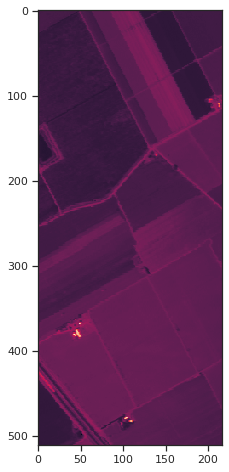

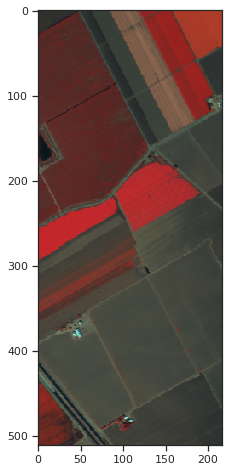

In [0]:
# display an RGB or false colour image
thefigsize = (10,8)# set figure size
plt.figure(figsize=thefigsize)
plt.imshow(salinas_data[:,:,10])
rgbArray = np.zeros((height, width, 3), 'uint8')

rgbArray[..., 0] = salinas_data_normalized[:,:,50]*255
rgbArray[..., 1] = salinas_data_normalized[:,:,20]*255
rgbArray[..., 2] = salinas_data_normalized[:,:,10]*255
img = Image.fromarray(rgbArray)
plt.figure(figsize=thefigsize)
plt.imshow(img, cmap='terrain')



In [0]:

# sample random subset of images
imagesamples = []
for i in range(Nsamples):
    xr=np.random.randint(0,salinas_data_normalized.shape[1]-1)
    yr=np.random.randint(0,salinas_data_normalized.shape[0]-1)
    imagesamples.append(salinas_data_normalized[yr,xr,:])
# convert to pandas dataframe
imagessamplesDF=pd.DataFrame(imagesamples)

print(type(np.asarray(imagesamples)))
print(imagessamplesDF.head)


print(imagessamplesDF.shape)


gbrbm100 = GBRBM(n_visible=224, n_hidden=100, learning_rate=0.01, momentum=0.95, err_function='mse', use_tqdm=True, sample_visible=False, sigma=1)
gbrbm75 = GBRBM(n_visible=224, n_hidden=75, learning_rate=0.01, momentum=0.95, err_function='mse', use_tqdm=True, sample_visible=False, sigma=1)
gbrbm50 = GBRBM(n_visible=224, n_hidden=50, learning_rate=0.01, momentum=0.95, err_function='mse', use_tqdm=True, sample_visible=False, sigma=1)
gbrbm25 = GBRBM(n_visible=224, n_hidden=25, learning_rate=0.01, momentum=0.95, err_function='mse', use_tqdm=True, sample_visible=False, sigma=1)
errs100 = gbrbm100.fit(np.asarray(imagesamples), n_epoches=300, batch_size=10)
errs75 = gbrbm75.fit(np.asarray(imagesamples), n_epoches=300, batch_size=10)
errs50 = gbrbm50.fit(np.asarray(imagesamples), n_epoches=300, batch_size=10)
errs25 = gbrbm25.fit(np.asarray(imagesamples), n_epoches=300, batch_size=10)
# plt.plot(errs)
# plt.show()

# image_rec = gbrbm.reconstruct(salinas_data_normalized.reshape(1,-1))
# plt.figure(figsize=thefigsize)
# plt.imshow(image_rec)


In [0]:
print(np.asarray(imagesamples).shape)
print(salinas_data_normalized.shape)
flatten_salinas_data_normalized = np.zeros([width*height,bands])
print(flatten_salinas_data_normalized.shape)

for i in range(salinas_data_normalized.shape[2]):
    flatten_salinas_data_normalized[:,i] = salinas_data_normalized[:,:,i].flatten() 

print(flatten_salinas_data_normalized)

(20000, 224)
(512, 217, 224)
(111104, 224)
[[0.03296822 0.042837   0.06496042 ... 0.0027112  0.00336189 0.00260275]
 [0.03296822 0.042837   0.05780284 ... 0.0027112  0.003145   0.00325344]
 [0.03296822 0.042837   0.06496042 ... 0.0027112  0.0027112  0.00281965]
 ...
 [0.04999458 0.04543976 0.0746123  ... 0.0027112  0.00401258 0.00260275]
 [0.04999458 0.04543976 0.0746123  ... 0.00336189 0.00444637 0.00325344]
 [0.04229476 0.0545494  0.0746123  ... 0.003145   0.00401258 0.00281965]]


In [0]:
def show_images(images, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.
    
    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.
    
    cols (Default = 1): Number of columns in figure (number of rows is 
                        set to np.ceil(n_images/float(cols))).
    
    titles: List of titles corresponding to each image. Must have
            the same length as titles.
    """
    assert((titles is None)or (len(images) == len(titles)))
    n_images = len(images)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):
        a = fig.add_subplot(cols, np.ceil(n_images/float(cols)), n + 1)
        
        plt.imshow(image, cmap="terrain")
        a.set_title(title)
    print(fig.get_size_inches()*n_images)
    #fig.set_size_inches(np.array(fig.get_size_inches()/4) * n_images/2)
    
    fig.set_size_inches((cols * 2,n_images/2))
    plt.show()

In [0]:
transformed100 = gbrbm100.transform(imagesamples)
print(transformed100.shape)

transformed_salinas_data100 = gbrbm100.transform(flatten_salinas_data_normalized)
print(transformed_salinas_data100.shape)
# transformed_salinas_image = transformed_salinas_data.reshape((512, 217, 224))
reconstructed_salinas_data100 = gbrbm100.reconstruct(flatten_salinas_data_normalized)
print(reconstructed_salinas_data100.shape)

reconstructed_image100 = reconstructed_salinas_data100.reshape((512, 217, 224))

transformed75 = gbrbm75.transform(imagesamples)
transformed50 = gbrbm50.transform(imagesamples)
transformed25 = gbrbm25.transform(imagesamples)

transformed_salinas_data75 = gbrbm75.transform(flatten_salinas_data_normalized)
transformed_salinas_data50 = gbrbm50.transform(flatten_salinas_data_normalized)
transformed_salinas_data25 = gbrbm25.transform(flatten_salinas_data_normalized)

reconstructed_salinas_data75 = gbrbm75.reconstruct(flatten_salinas_data_normalized)
reconstructed_salinas_data50 = gbrbm50.reconstruct(flatten_salinas_data_normalized)
reconstructed_salinas_data25 = gbrbm25.reconstruct(flatten_salinas_data_normalized)

reconstructed_image75 = reconstructed_salinas_data75.reshape((512, 217, 224))
reconstructed_image50 = reconstructed_salinas_data50.reshape((512, 217, 224))
reconstructed_image25 = reconstructed_salinas_data25.reshape((512, 217, 224))

(20000, 100)
(111104, 100)
(111104, 224)


In [0]:
transformed_combined = np.append(transformed100, transformed75, axis=1)
transformed_combined = np.append(transformed_combined, transformed50, axis=1)
transformed_combined = np.append(transformed_combined, transformed25, axis=1)

transformed_salinas_data_combined = np.append(transformed_salinas_data100, transformed_salinas_data75, axis = 1)
transformed_salinas_data_combined = np.append(transformed_salinas_data_combined, transformed_salinas_data50, axis = 1)
transformed_salinas_data_combined = np.append(transformed_salinas_data_combined, transformed_salinas_data25, axis = 1)

In [0]:
print(transformed_combined.shape)
print(transformed_salinas_data_combined.shape)

(20000, 250)
(111104, 250)


[1344.  896.]


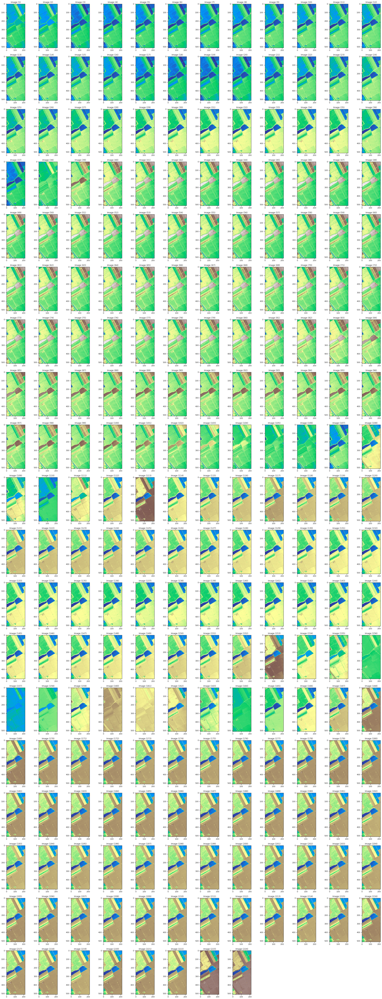

In [0]:
images = []
for i in range(224):
    images.append(reconstructed_image100[:,:,i])
show_images(images, cols= 20)


[1344.  896.]


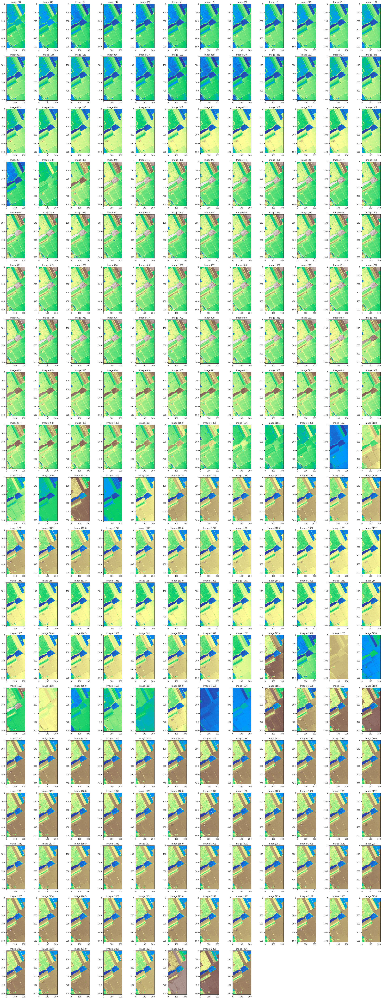

In [0]:
images = []
for i in range(224):
    images.append(reconstructed_image75[:,:,i])
show_images(images, cols= 20)

[1344.  896.]


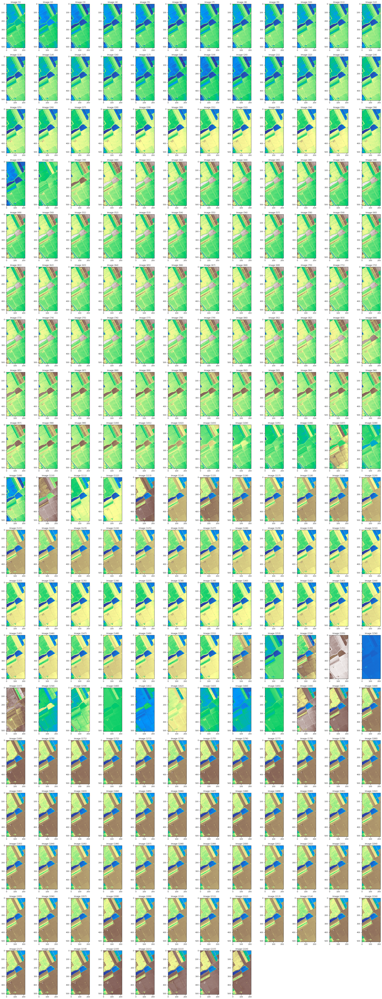

In [0]:
images = []
for i in range(224):
    images.append(reconstructed_image50[:,:,i])
show_images(images, cols= 20)

[1344.  896.]


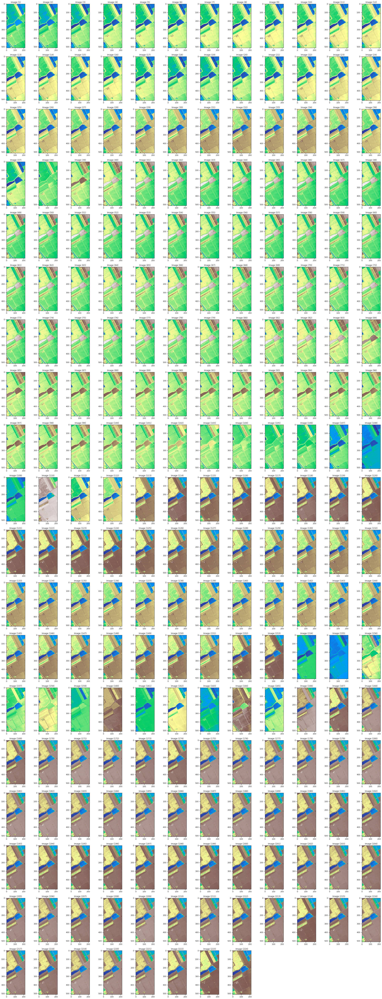

In [0]:
images = []
for i in range(224):
    images.append(reconstructed_image25[:,:,i])
show_images(images, cols= 20)

In [0]:
print(salinas_data.shape)
transformed_combined_image = transformed_salinas_data_combined.reshape((512, 217, 250))
print(transformed_combined_image.shape)

(512, 217, 224)
(512, 217, 250)


(111104, 250)
Fitting...
Predicting...
Reconstructing image...


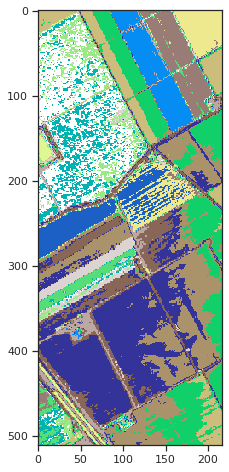

In [0]:

NUMBER_OF_CLUSTERS = 16 
# fit kmeans to samples:
from sklearn.cluster import KMeans

imagessamplesDF = pd.DataFrame(transformed_salinas_data_combined)
print(imagessamplesDF.shape)

KMmodel = KMeans(n_clusters=NUMBER_OF_CLUSTERS) 
print("Fitting...")
KMmodel.fit(imagessamplesDF)
print("Predicting...")
KM_train = list(KMmodel.predict(imagessamplesDF)) 
i=0
for k in KM_train:
    KM_train[i] = str(k) 
    i=i+1
imagessamplesDF2=imagessamplesDF
imagessamplesDF2['group'] = KM_train


#  make the clustered image
imageclustered=np.empty((salinas_data.shape[0],salinas_data.shape[1]))
i=0
print("Reconstructing image...")
for row in transformed_combined_image:
    temp = KMmodel.predict(row) 
    imageclustered[i,:]=temp
    i=i+1
# plot the map of the clustered data
plt.figure(figsize=thefigsize)
plt.imshow(imageclustered, cmap=colour_map) 

In [0]:
plt.imshow(salinas_gt, cmap='terrain')

In [0]:
print(salinas_data_normalized.shape)
print(np.asarray(imagesamples).shape)

(512, 217, 224)
(20000, 224)


(20000, 100)


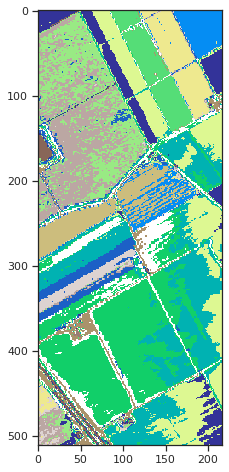

In [0]:
NUMBER_OF_CLUSTERS = 16 
# fit kmeans to samples:
from sklearn.cluster import KMeans

imagessamplesDF = pd.DataFrame(transformed100)
print(imagessamplesDF.shape)

KMmodel = KMeans(n_clusters=NUMBER_OF_CLUSTERS) 
KMmodel.fit(imagessamplesDF)
KM_train = list(KMmodel.predict(imagessamplesDF)) 
i=0
for k in KM_train:
    KM_train[i] = str(k) 
    i=i+1
imagessamplesDF2=imagessamplesDF
imagessamplesDF2['group'] = KM_train


#  make the clustered image
imageclustered=np.empty((salinas_data.shape[0],salinas_data.shape[1]))
i=0
transformed_image = transformed_salinas_data100.reshape((512, 217, 100))
for row in transformed_image:
    temp = KMmodel.predict(row) 
    imageclustered[i,:]=temp
    i=i+1
# plot the map of the clustered data
plt.figure(figsize=thefigsize)
plt.imshow(imageclustered, cmap=colour_map) 

In [0]:
mkdir /content/saves

mkdir: cannot create directory ‘/content/saves’: File exists


In [0]:
gbrbm100.save_weights(filename="gbrbm100", name="300epochs")

'gbrbm100'

In [0]:
cd saves/

[Errno 2] No such file or directory: 'saves/'
/content/saves/gbrbm100


In [0]:
mkdir gbrbm100

In [0]:
mkdir gbrbm75

mkdir: cannot create directory ‘gbrbm75’: File exists


In [0]:
mkdir gbrbm50

In [0]:
mkdir gbrbm25

In [0]:
ls

gbrbm100/  gbrbm25/  gbrbm50/  gbrbm75/


In [0]:
cd /content/saves/gbrbm75 

/content/saves/gbrbm75


In [0]:
gbrbm100.save_weights("gbrbm100", "300epochs")

'gbrbm100'

In [0]:
cd /content/saves/gbrbm50/ 

/content/saves/gbrbm50


In [0]:
gbrbm75.save_weights("gbrbm75", "300epochs")

'gbrbm75'

In [0]:
cd /content/saves/gbrbm50

/content/saves/gbrbm50


In [0]:
gbrbm50.save_weights("gbrbm50", "300epochs")

'gbrbm50'

In [0]:
cd /content/saves/gbrbm25

/content/saves/gbrbm25


In [0]:
gbrbm25.save_weights("gbrbm25", "300epochs")

'gbrbm25'

In [0]:
!cp /content/saves/ /content/gdrive/'My Drive'/DeepL/ -r